# Compare Simulated Contact Map with Experimental Hi-C

Hi-C contact maps are provided by Rao et al. (2014) at GEO accession GSE63525.

### Import Modules

In [1]:
import os
import sys
import json

import skimage
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

### Specify Contact Maps

In [2]:
ref_cmap_path = "/scratch/users/jwakim/chromo_two_mark_phase_transition/output/Rao_data/chr_16_log_contacts.csv"
output_dir = "/scratch/users/jwakim/chromo_two_mark_phase_transition/output"
sim_cmap_file_name = "log_contact_matrix.csv"
binder_filename = "binders"
sim_ids = np.arange(32)+1

sims = [f"sim_{sim_id}" for sim_id in sim_ids]
sim_cmap_paths = [f"{output_dir}/{sim}/{sim_cmap_file_name}" for sim in sims]

# Parameter settings
cross_levels = (1.0, 1.5)
cp_HP1_levels = (-0.7, -0.6)
cp_PRC1_levels = (-0.7, -0.6)
HP1_self_levels = (-6.0, -5.5)
PRC1_self_levels = (-6.0, -5.5)

### Load Reference Contact Map

In [3]:
ref_cmap = pd.read_csv(ref_cmap_path, header=None).to_numpy()

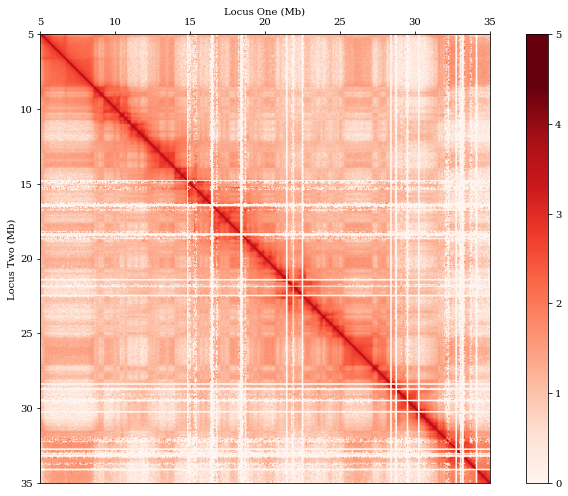

In [4]:
font = {'family' : 'serif',
        'weight':'normal',
        'size': 24}
plt.rc('font', **font)

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.5)
extents = [5, 35, 35, 5]
im = ax.imshow(ref_cmap, cmap="Reds", extent=extents)
ax.set_xticks([5, 10, 15, 20, 25, 30, 35])
ax.set_yticks([5, 10, 15, 20, 25, 30, 35])
ticks = np.arange(np.ceil(np.max(ref_cmap))+1)
boundaries = np.linspace(0, np.ceil(np.max(ref_cmap)), 1000)
ax.set_xlabel("Locus One (Mb)")
ax.set_ylabel("Locus Two (Mb)")
ax.xaxis.set_label_position("top")
ax.xaxis.tick_top()
fig.colorbar(im, cax=cax, orientation='vertical', ticks=ticks, boundaries=boundaries)
plt.tight_layout()
plt.show()

### Load Simulated Contact Map

In [5]:
sim_cmaps = {}
for i, sim_path in enumerate(sim_cmap_paths):
    print(f"Loading Contact Map: {sims[i]}")
    sim_cmap = pd.read_csv(sim_path, header=None).to_numpy()
    sim_cmaps[sims[i]] = sim_cmap

Loading Contact Map: sim_1
Loading Contact Map: sim_2
Loading Contact Map: sim_3
Loading Contact Map: sim_4
Loading Contact Map: sim_5
Loading Contact Map: sim_6
Loading Contact Map: sim_7
Loading Contact Map: sim_8
Loading Contact Map: sim_9
Loading Contact Map: sim_10
Loading Contact Map: sim_11
Loading Contact Map: sim_12
Loading Contact Map: sim_13
Loading Contact Map: sim_14
Loading Contact Map: sim_15
Loading Contact Map: sim_16
Loading Contact Map: sim_17
Loading Contact Map: sim_18
Loading Contact Map: sim_19
Loading Contact Map: sim_20
Loading Contact Map: sim_21
Loading Contact Map: sim_22
Loading Contact Map: sim_23
Loading Contact Map: sim_24
Loading Contact Map: sim_25
Loading Contact Map: sim_26
Loading Contact Map: sim_27
Loading Contact Map: sim_28
Loading Contact Map: sim_29
Loading Contact Map: sim_30
Loading Contact Map: sim_31
Loading Contact Map: sim_32


### Isolate Genomic Region of Interest

Isolate genomic region between 5 Mb and 35 Mb for comparison. Assume chromosome 16 is 90 Mb large and that nucleosomes are evenly spaced. We are interested in nucleosome indices between (5/90) and (35/90) of the maximum nucleosome position. 

In [6]:
for i, sim in enumerate(sims):
    max_ind = len(sim_cmaps[sim]) - 1
    lower_bound = int(round((5 / 90) * max_ind))
    upper_bound = int(round((35 / 90) * max_ind))
    sim_cmaps[sim] = sim_cmaps[sim][lower_bound:upper_bound, lower_bound:upper_bound]

### Rescale Simulated Contact Maps to Match Experimental Hi-C

A common shape between experimental and simulated contact maps allows for direct evaluation of structural correlation.

In [7]:
sim_cmaps_rescaled = {}
for i, sim in enumerate(sims):
    sim_cmaps_rescaled[sim] = skimage.transform.resize(
        sim_cmaps[sim], (ref_cmap.shape[0], ref_cmap.shape[1]), anti_aliasing=True
    )

### Plot Rescaled Simulated Contact Maps

Simulation: sim_1


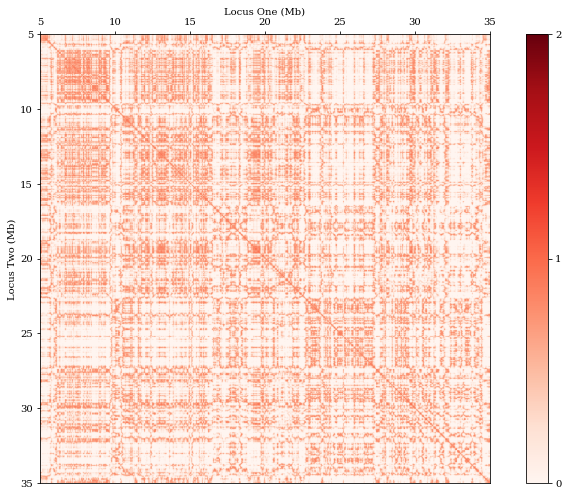



Simulation: sim_2


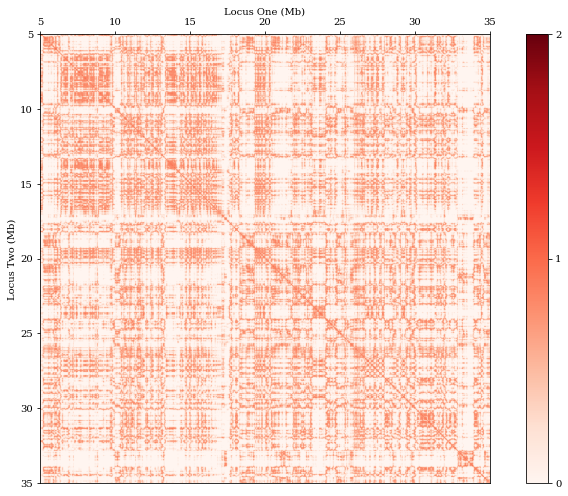



Simulation: sim_3


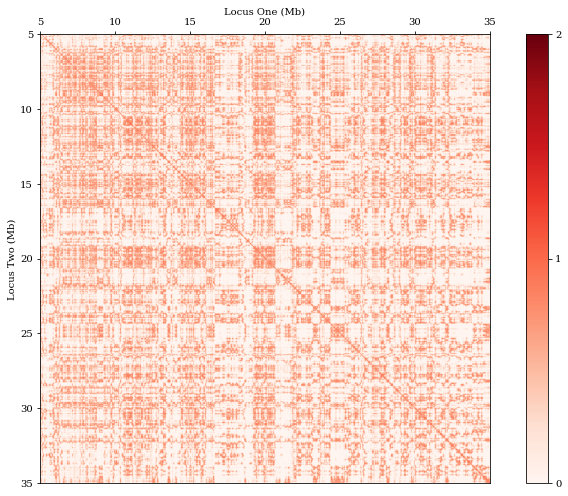



Simulation: sim_4


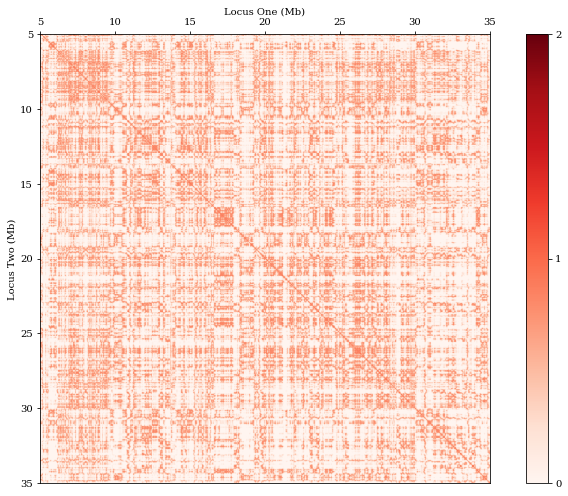



Simulation: sim_5


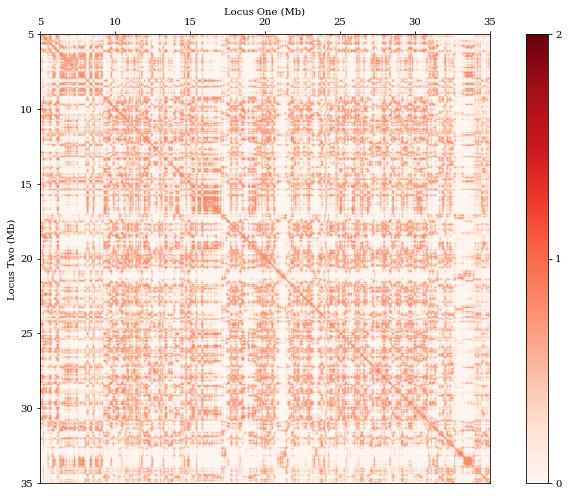



Simulation: sim_6


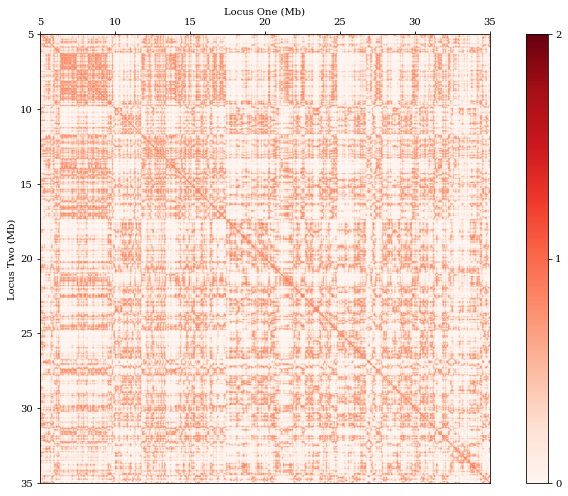



Simulation: sim_7


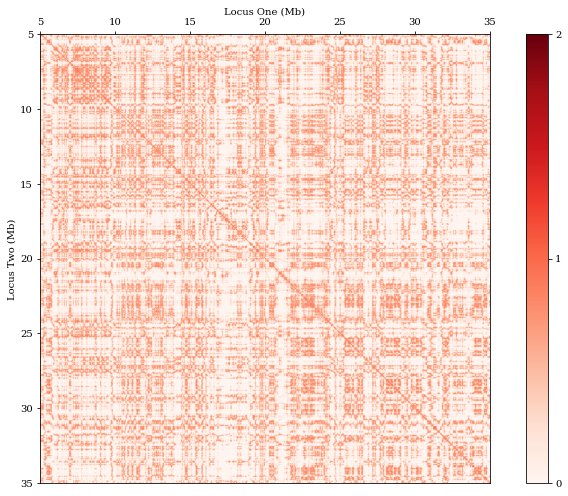



Simulation: sim_8


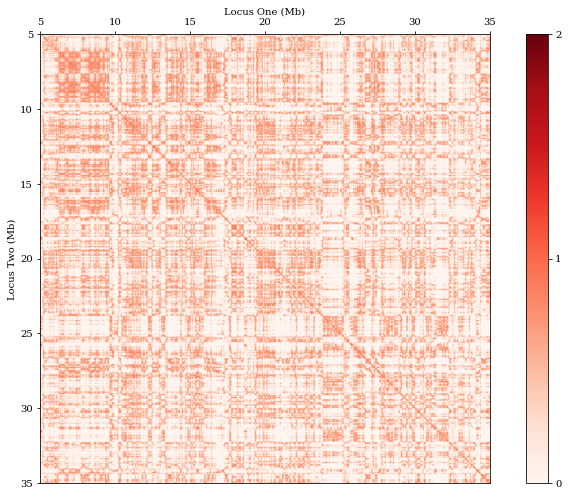



Simulation: sim_9


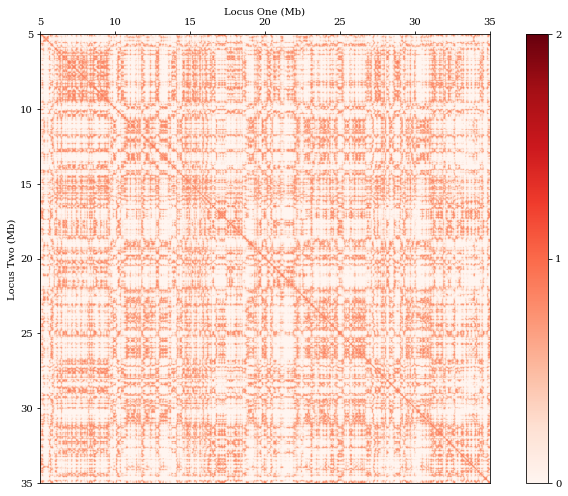



Simulation: sim_10


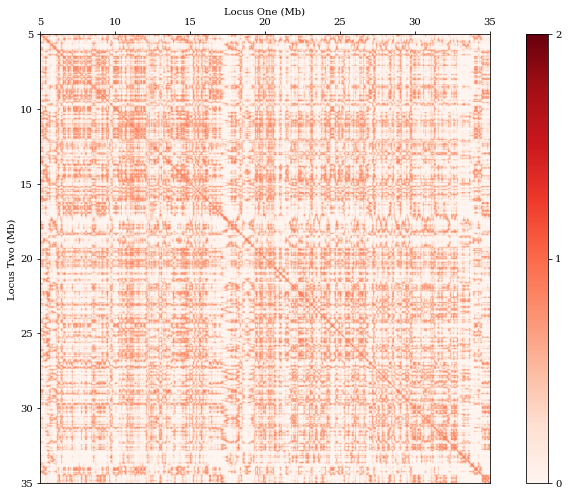



Simulation: sim_11


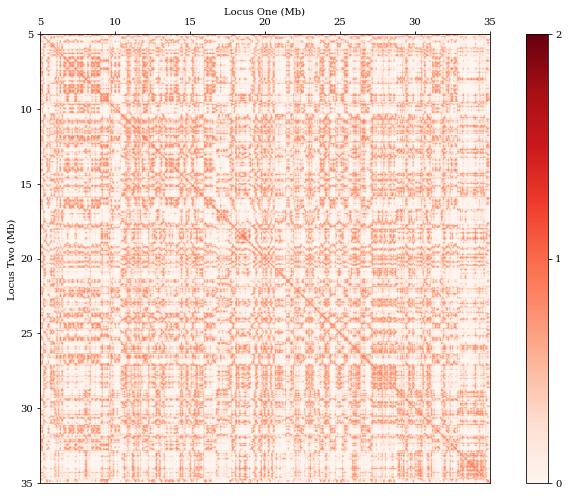



Simulation: sim_12


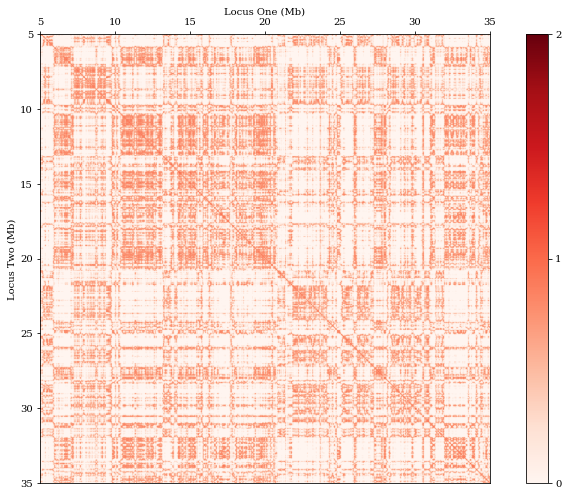



Simulation: sim_13


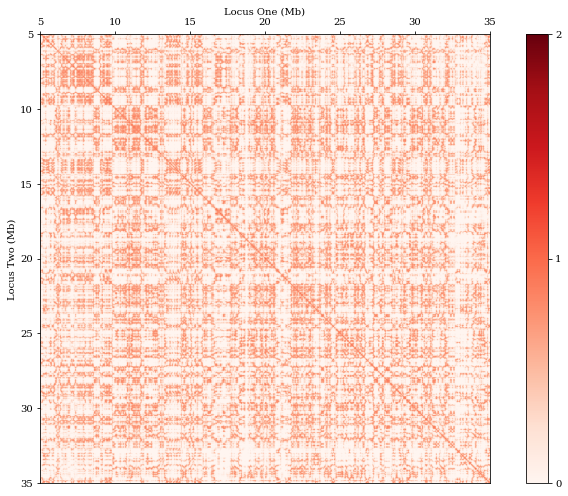



Simulation: sim_14


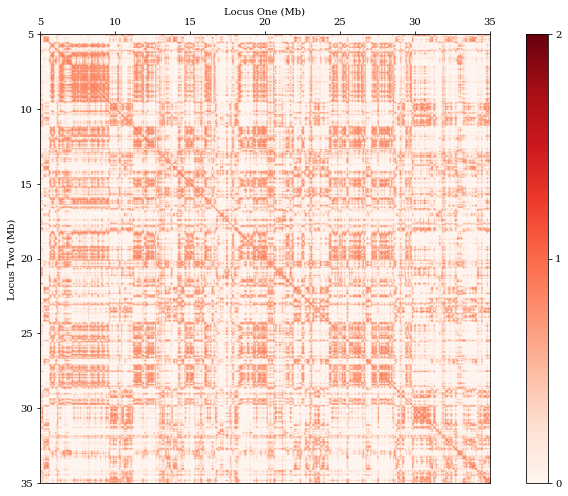



Simulation: sim_15


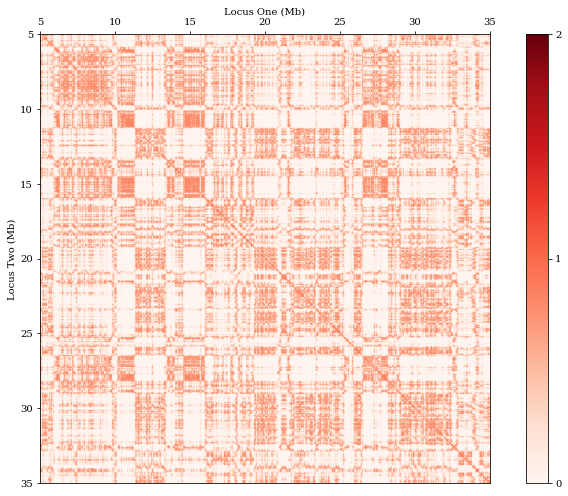



Simulation: sim_16


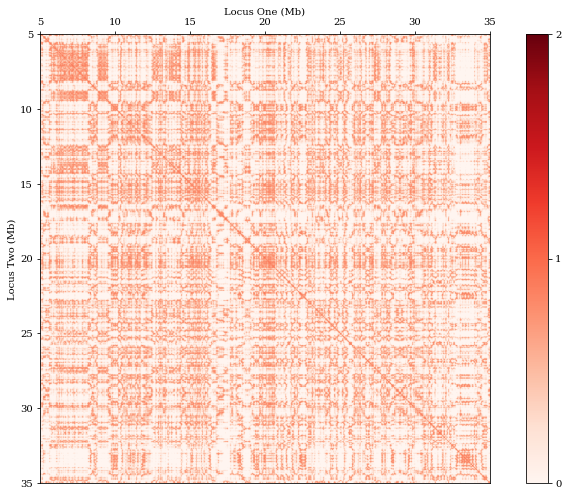



Simulation: sim_17


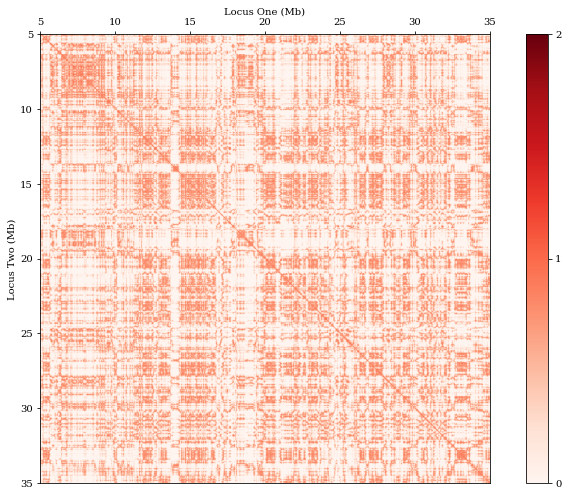



Simulation: sim_18


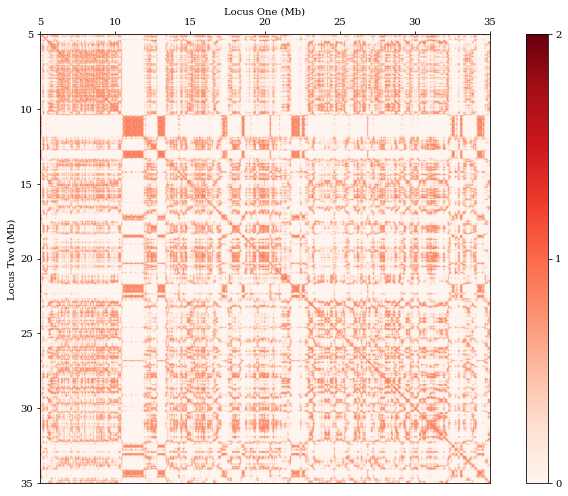



Simulation: sim_19


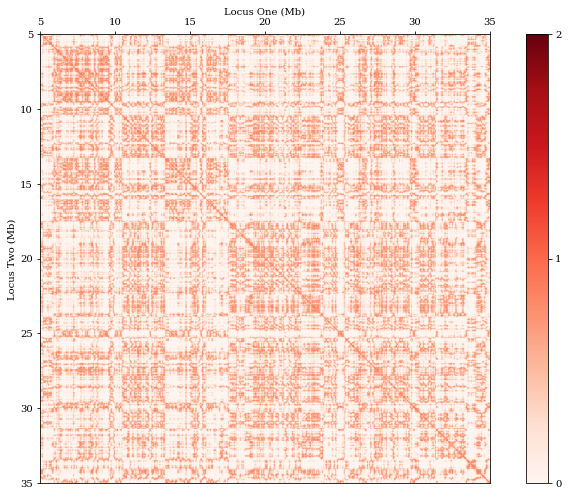



Simulation: sim_20


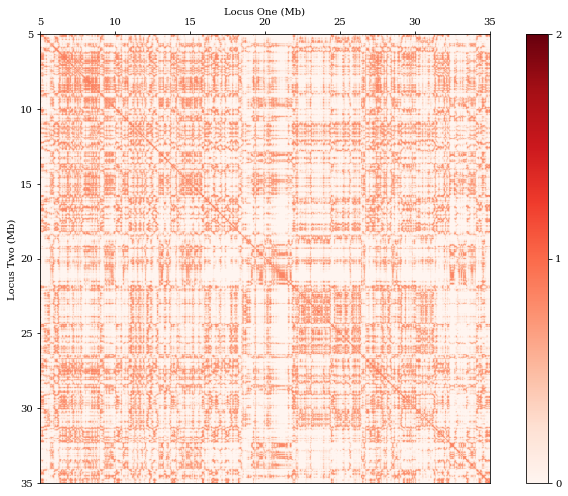



Simulation: sim_21


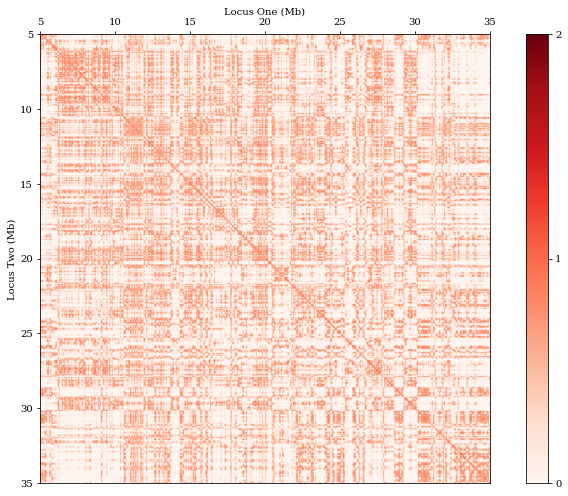



Simulation: sim_22


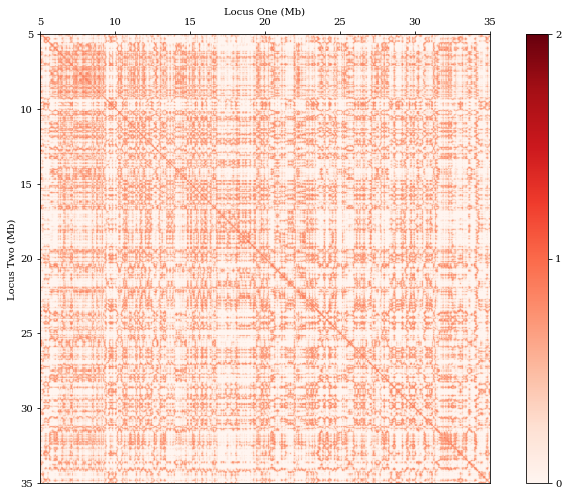



Simulation: sim_23


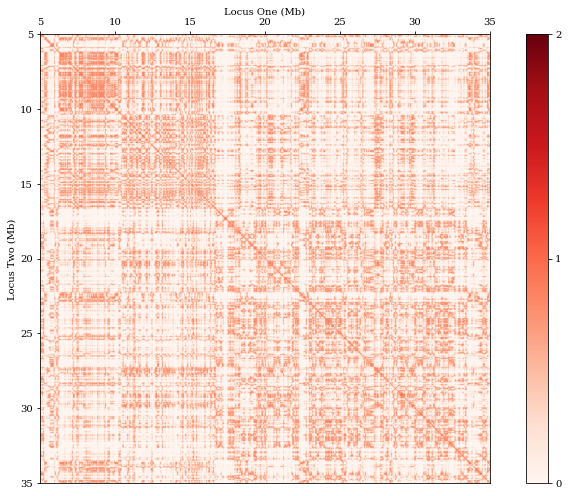



Simulation: sim_24


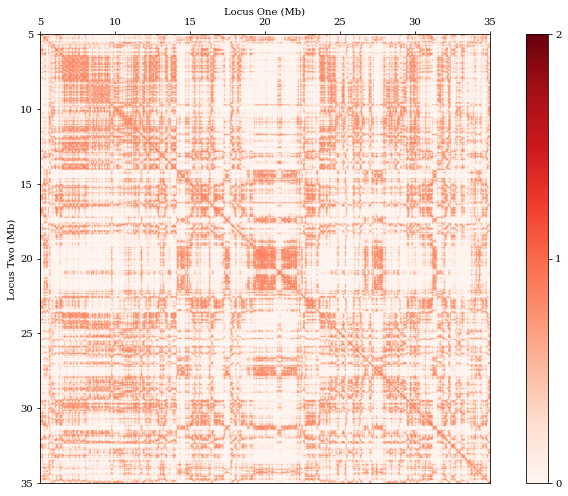



Simulation: sim_25


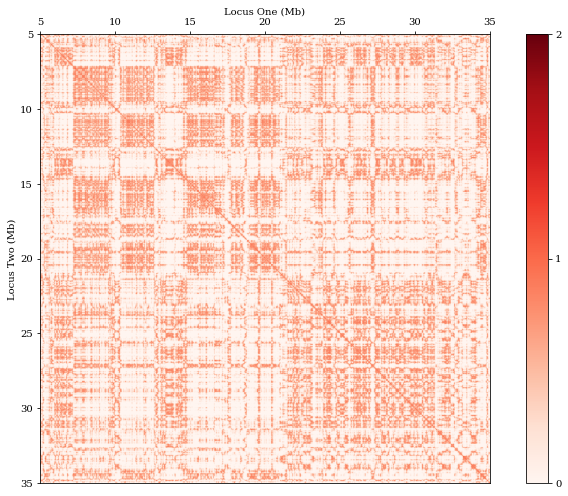



Simulation: sim_26


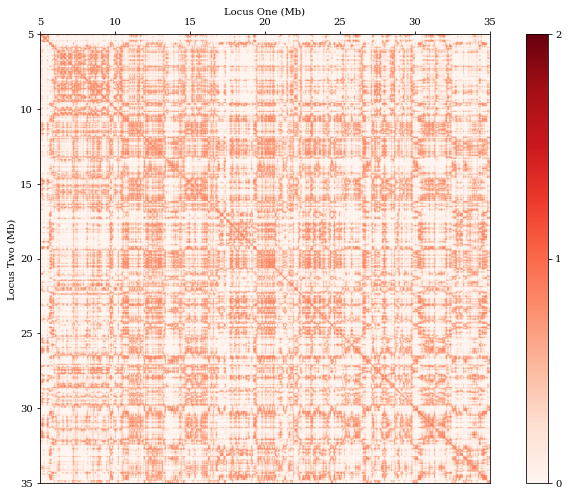



Simulation: sim_27


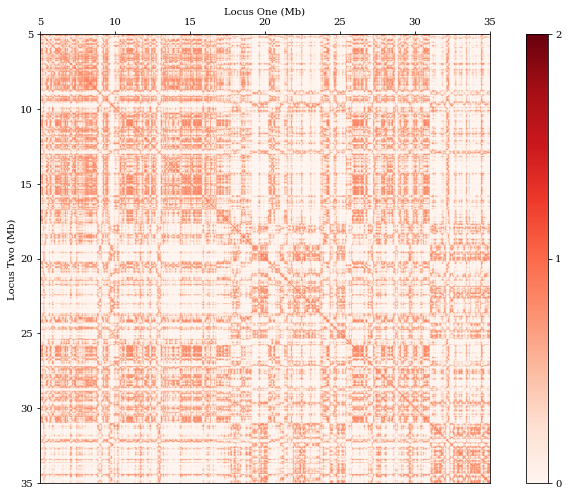



Simulation: sim_28


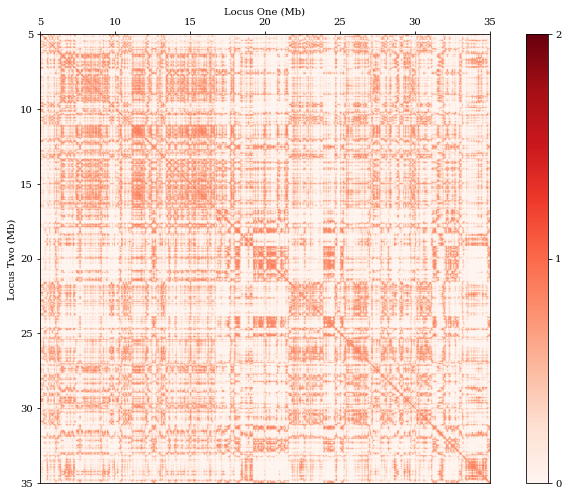



Simulation: sim_29


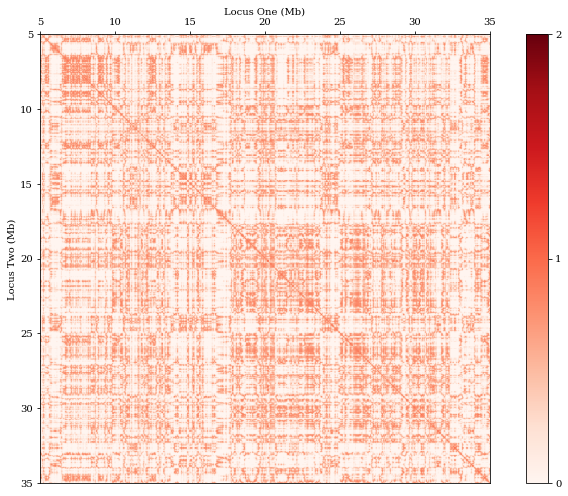



Simulation: sim_30


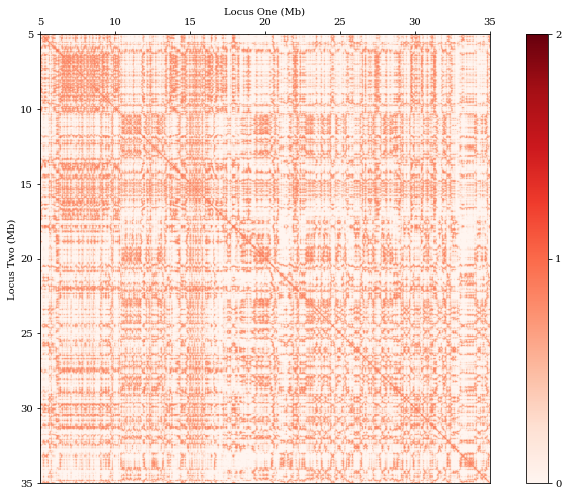



Simulation: sim_31


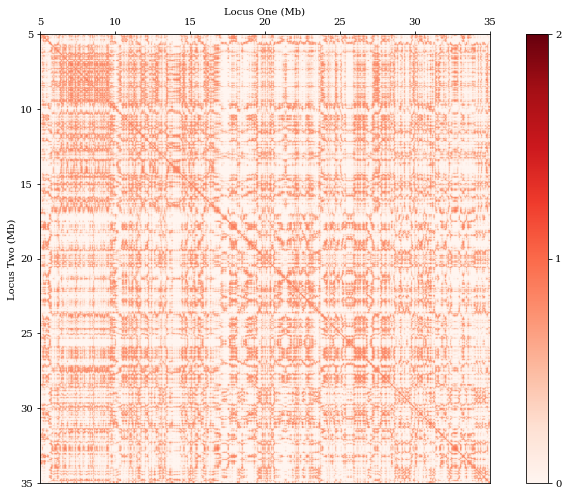



Simulation: sim_32


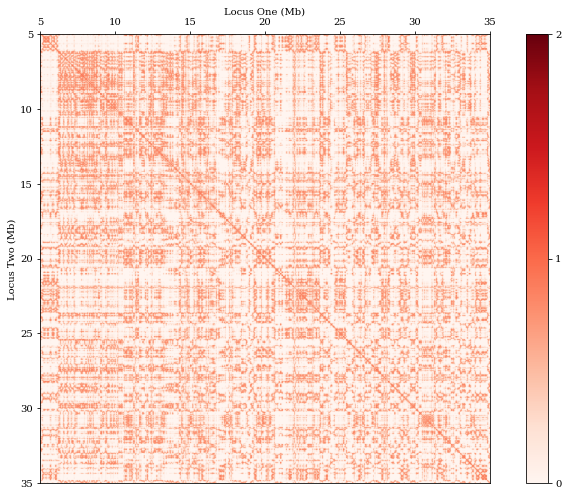

In [8]:
# Define a common colorbar
max_intensity = 0
for sim in sims:
    max_intensity_sim = np.ceil(np.max(sim_cmaps_rescaled[sim]))
    if max_intensity_sim > max_intensity:
        max_intensity = max_intensity_sim

# Create simulated contact maps
for i, sim in enumerate(sims):
    print(f"Simulation: {sim}")
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.5)
    extents = [5, 35, 35, 5]
    im = ax.imshow(sim_cmaps_rescaled[sim], cmap="Reds", extent=extents, vmin=0, vmax=max_intensity)
    ax.set_xticks([5, 10, 15, 20, 25, 30, 35])
    ax.set_yticks([5, 10, 15, 20, 25, 30, 35])
    ticks = np.arange(max_intensity+1)
    boundaries = np.linspace(0, max_intensity, 1000)
    ax.set_xlabel("Locus One (Mb)")
    ax.set_ylabel("Locus Two (Mb)")
    ax.xaxis.set_label_position("top")
    ax.xaxis.tick_top()
    fig.colorbar(im, cax=cax, orientation='vertical', ticks=ticks, boundaries=boundaries)
    plt.tight_layout()
    plt.show()
    print("\n")

### Correlated Experimental and Simulated Contact Maps

Simulation: sim_1


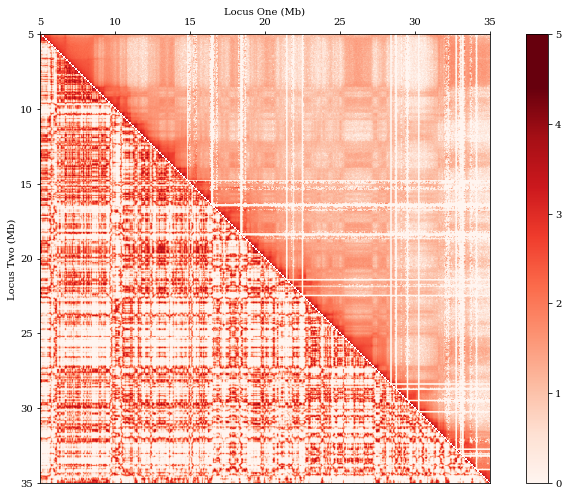

Correlation Coefficient: 0.115



Simulation: sim_2


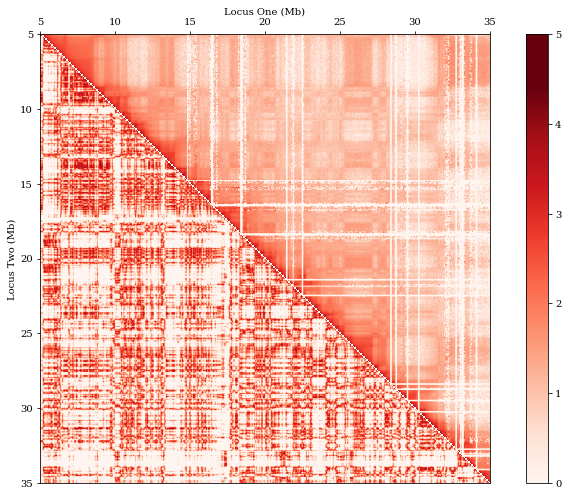

Correlation Coefficient: 0.109



Simulation: sim_3


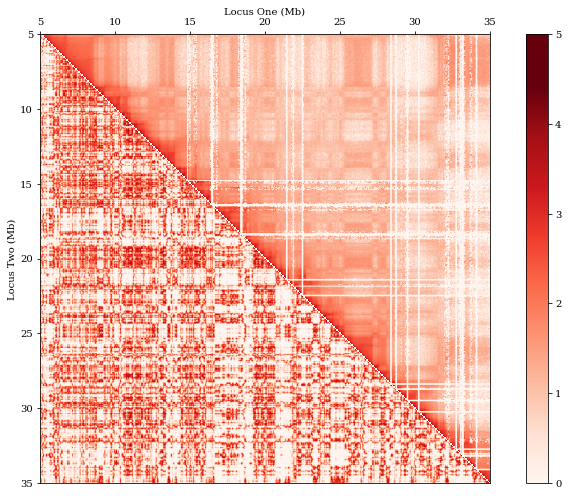

Correlation Coefficient: 0.065



Simulation: sim_4


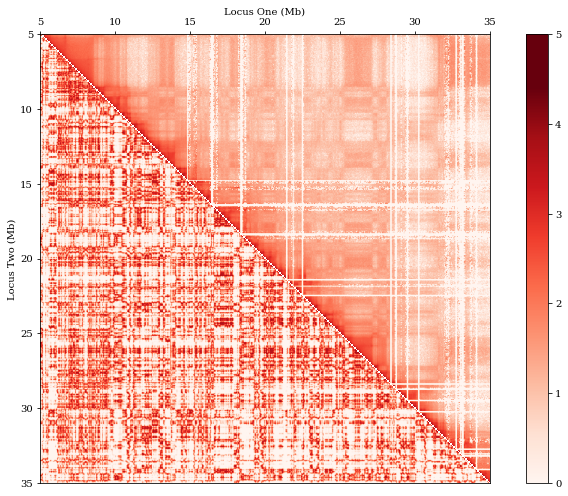

Correlation Coefficient: 0.118



Simulation: sim_5


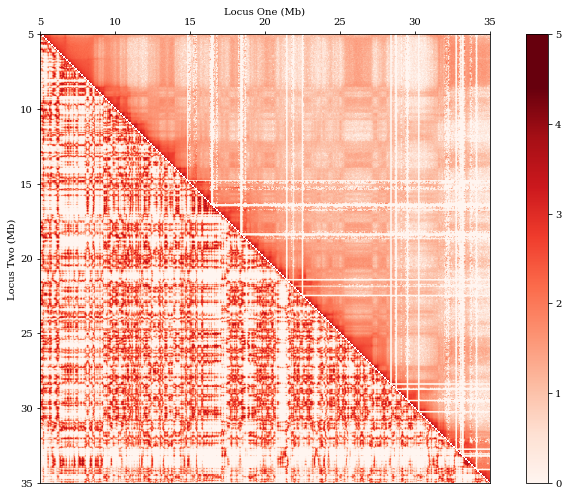

Correlation Coefficient: 0.098



Simulation: sim_6


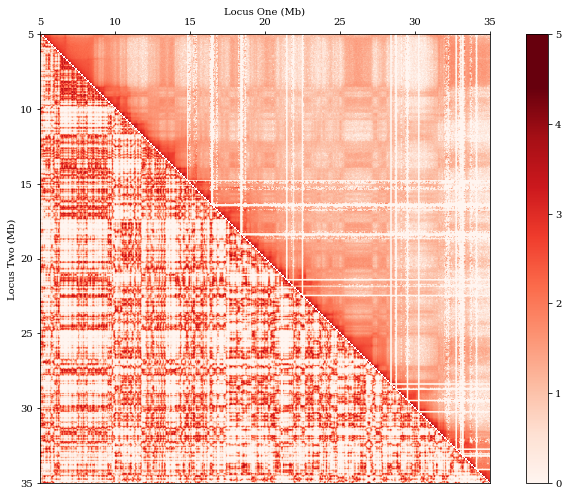

Correlation Coefficient: 0.077



Simulation: sim_7


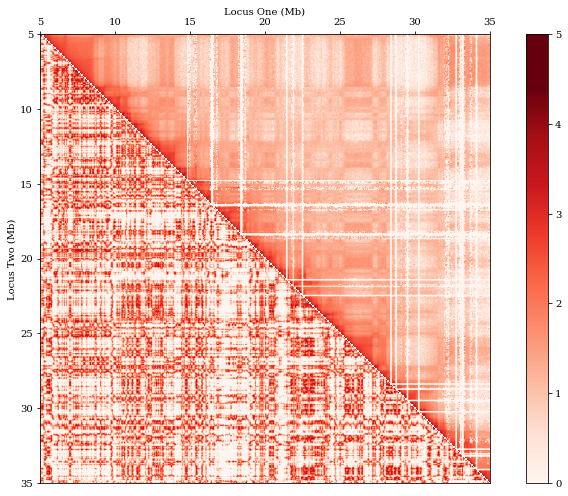

Correlation Coefficient: 0.067



Simulation: sim_8


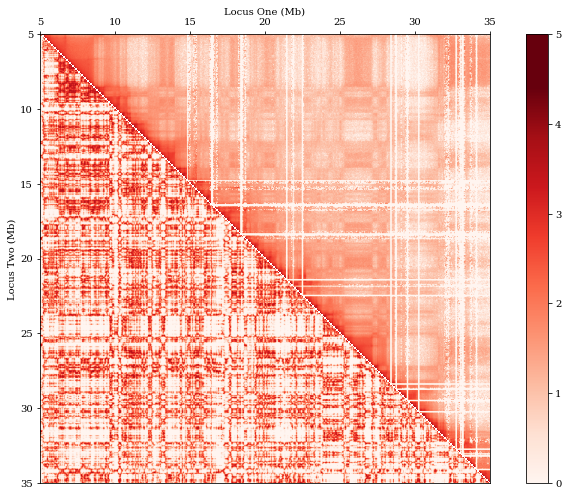

Correlation Coefficient: 0.082



Simulation: sim_9


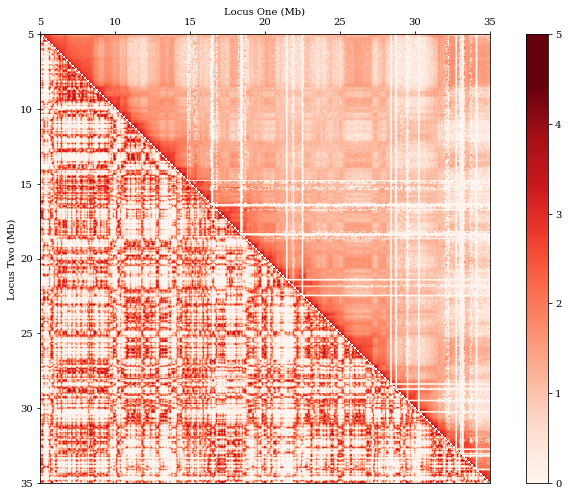

Correlation Coefficient: 0.099



Simulation: sim_10


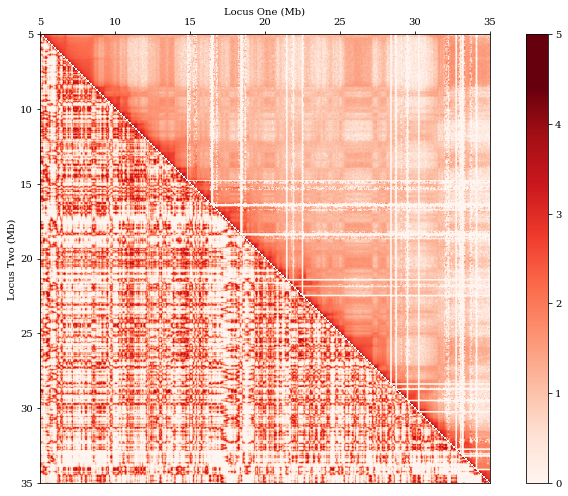

Correlation Coefficient: 0.104



Simulation: sim_11


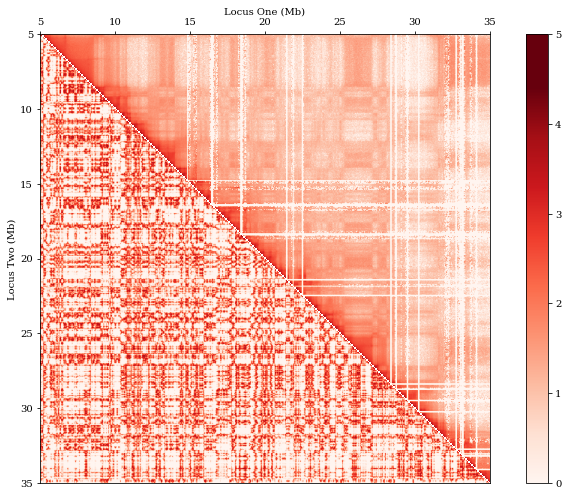

Correlation Coefficient: 0.074



Simulation: sim_12


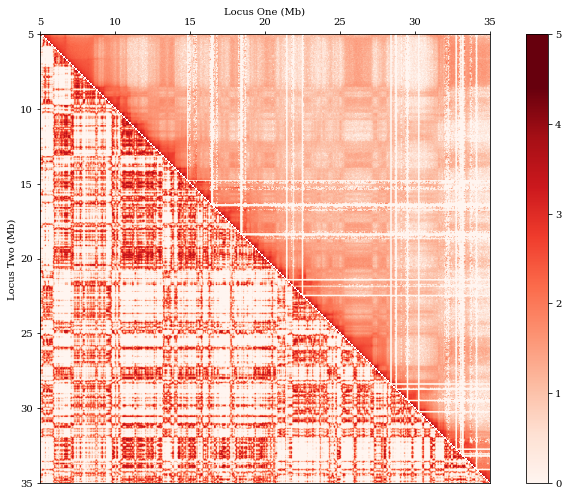

Correlation Coefficient: 0.078



Simulation: sim_13


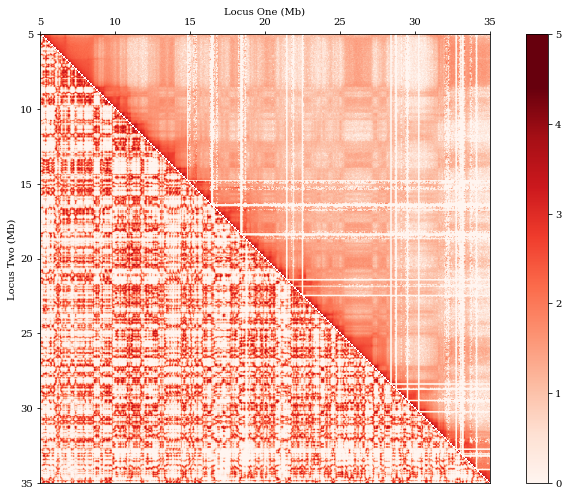

Correlation Coefficient: 0.083



Simulation: sim_14


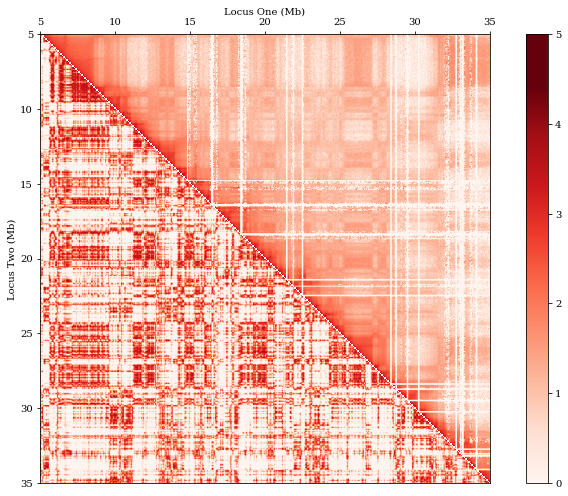

Correlation Coefficient: 0.106



Simulation: sim_15


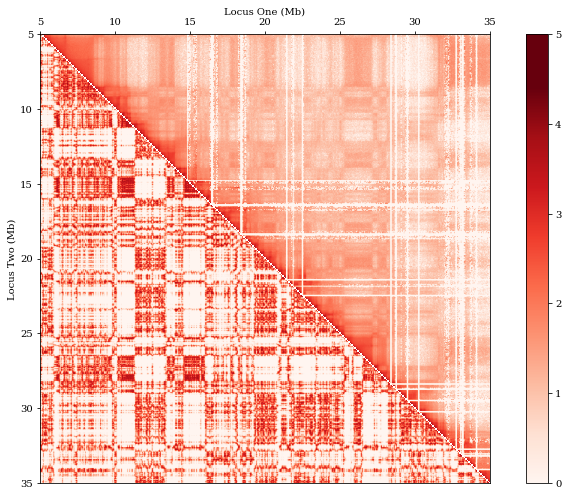

Correlation Coefficient: 0.084



Simulation: sim_16


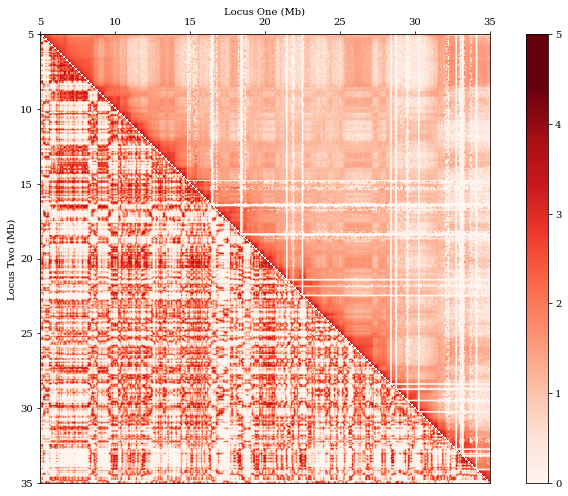

Correlation Coefficient: 0.092



Simulation: sim_17


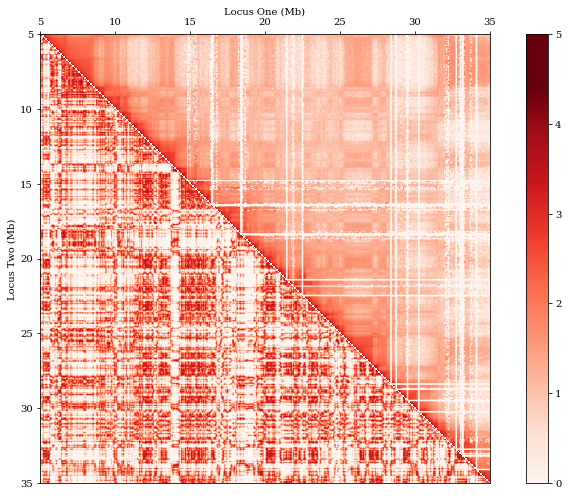

Correlation Coefficient: 0.067



Simulation: sim_18


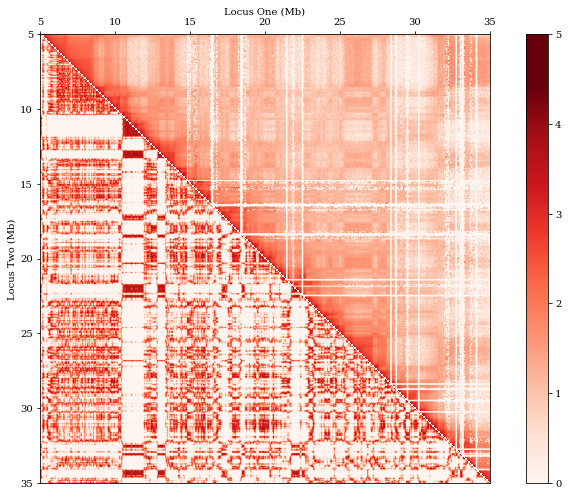

Correlation Coefficient: 0.119



Simulation: sim_19


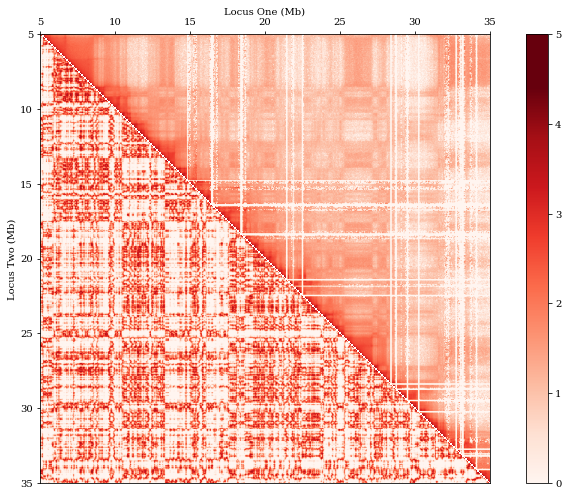

Correlation Coefficient: 0.082



Simulation: sim_20


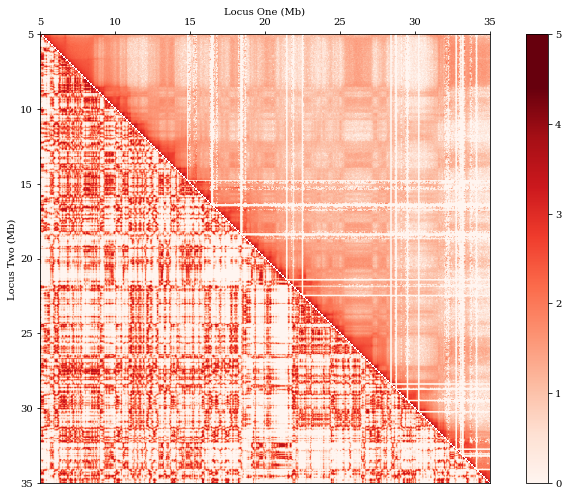

Correlation Coefficient: 0.108



Simulation: sim_21


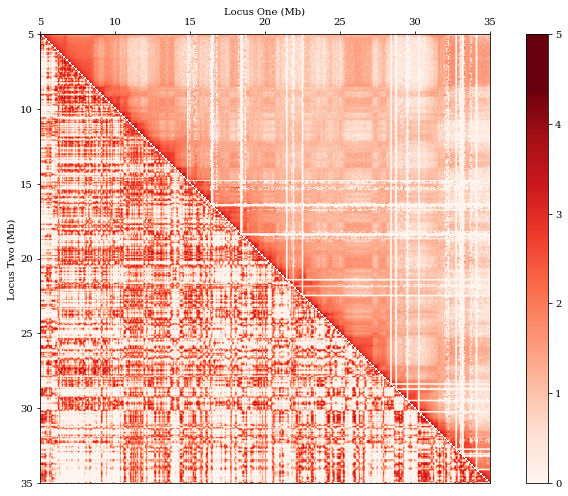

Correlation Coefficient: 0.078



Simulation: sim_22


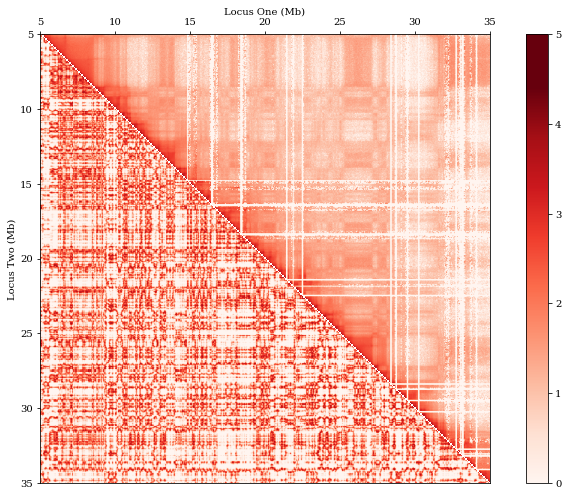

Correlation Coefficient: 0.086



Simulation: sim_23


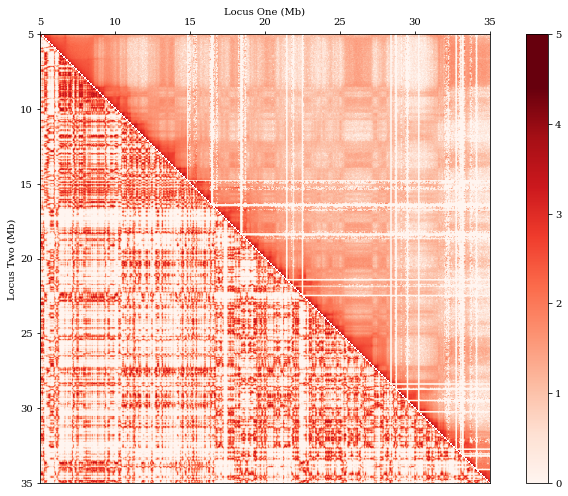

Correlation Coefficient: 0.128



Simulation: sim_24


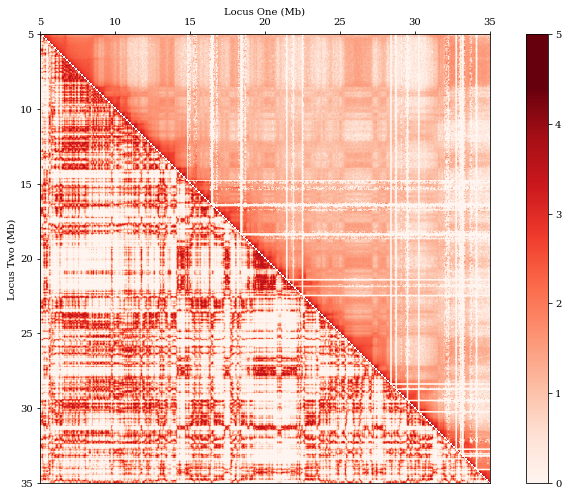

Correlation Coefficient: 0.092



Simulation: sim_25


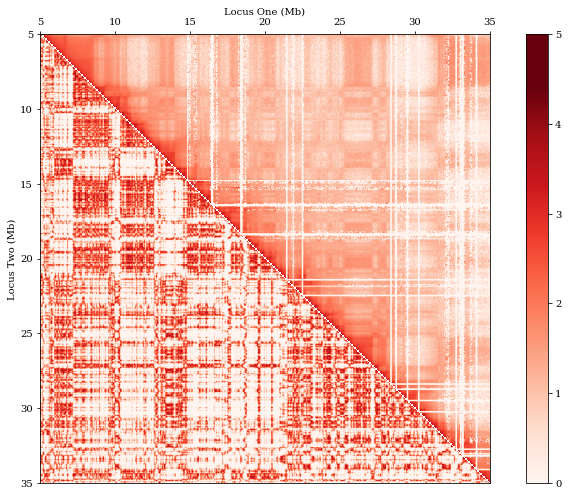

Correlation Coefficient: 0.104



Simulation: sim_26


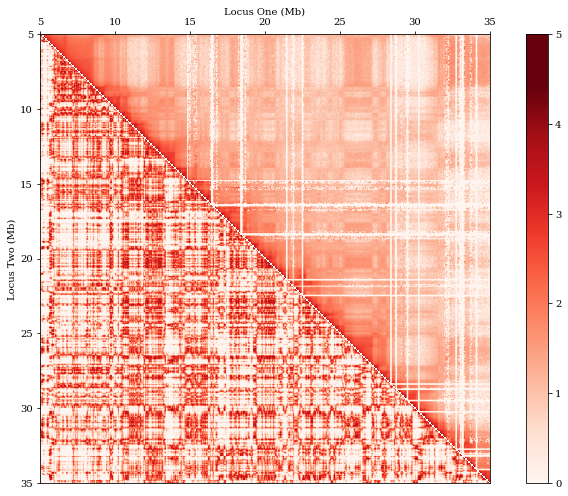

Correlation Coefficient: 0.08



Simulation: sim_27


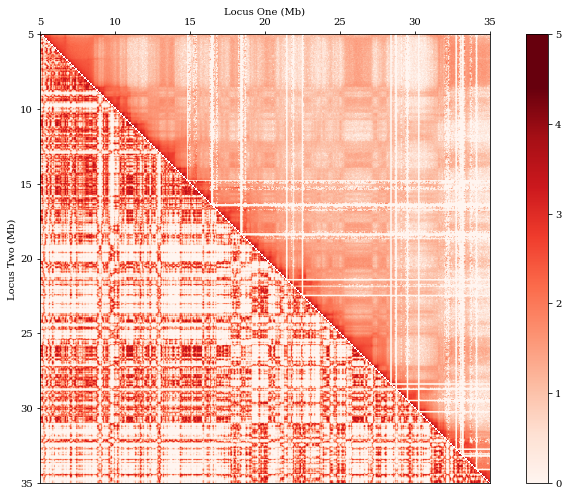

Correlation Coefficient: 0.085



Simulation: sim_28


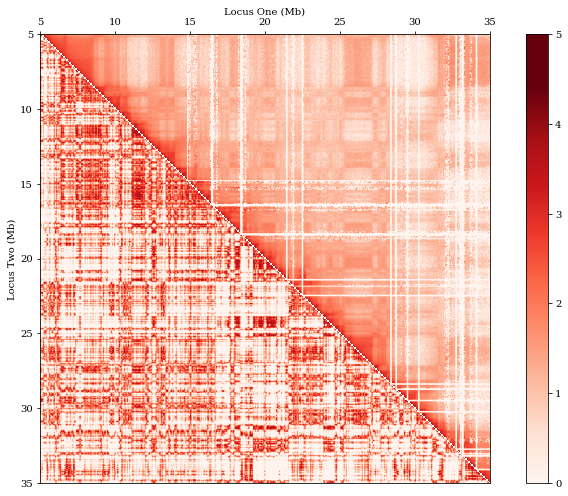

Correlation Coefficient: 0.1



Simulation: sim_29


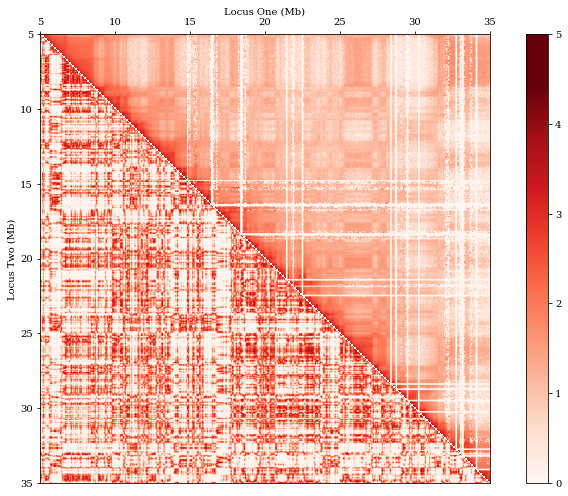

Correlation Coefficient: 0.096



Simulation: sim_30


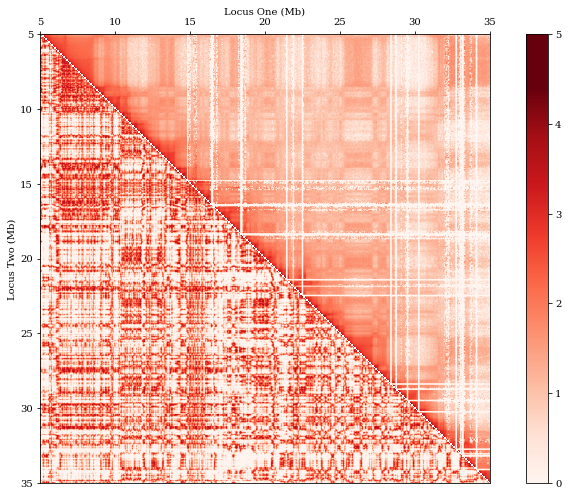

Correlation Coefficient: 0.1



Simulation: sim_31


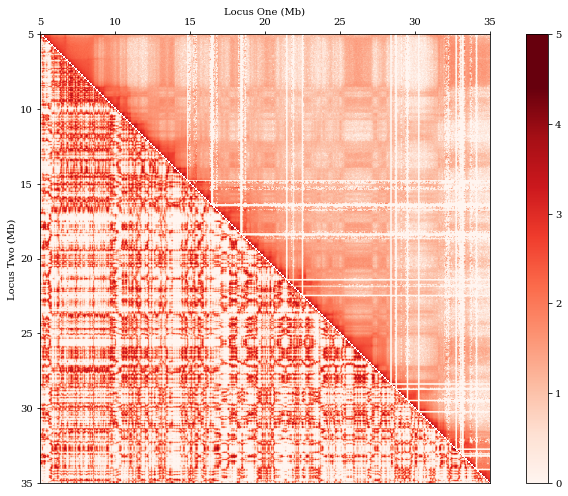

Correlation Coefficient: 0.119



Simulation: sim_32


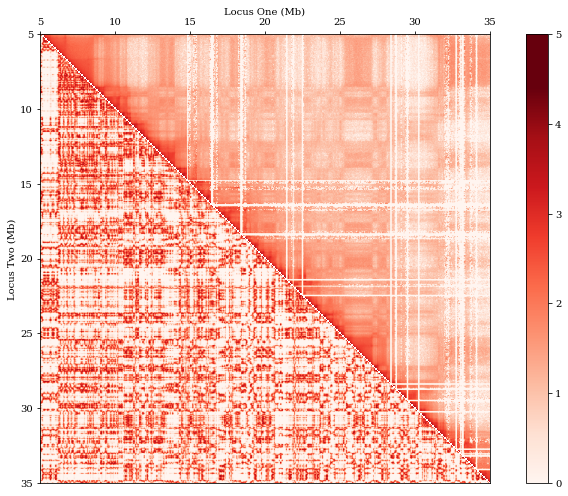

Correlation Coefficient: 0.075





In [9]:
ref_cmap_upper = np.triu(ref_cmap)
ref_cmap_plot = ref_cmap_upper.copy()

for i in range(len(ref_cmap_plot)):
    for j in range(i):
        ref_cmap_plot[i, j] = np.nan
        
ref_cmap_max_intensity = np.max(ref_cmap_upper)

correlation_coefficients = {}
for sim in sims:
    
    print(f"Simulation: {sim}")

    sim_cmap_lower = np.tril(sim_cmaps_rescaled[sim])
    sim_cmap_lower_scaled = sim_cmap_lower * (ref_cmap_max_intensity / np.max(sim_cmap_lower))
    sim_cmap_plot = sim_cmap_lower_scaled.copy()
    for i in range(len(sim_cmap_plot)):
        for j in range(i):
            sim_cmap_plot[j, i] = np.nan
            
    correlation_coefficient = np.corrcoef(ref_cmap.flat, sim_cmaps_rescaled[sim].flat)[0, 1]
    correlation_coefficients[sim] = correlation_coefficient

    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.5)
    extents = [5, 35, 35, 5]
    im = ax.imshow(ref_cmap_plot, cmap="Reds", extent=extents)
    im = ax.imshow(sim_cmap_plot, cmap="Reds", extent=extents)
    ax.set_xticks([5, 10, 15, 20, 25, 30, 35])
    ax.set_yticks([5, 10, 15, 20, 25, 30, 35])
    ticks = np.arange(np.ceil(np.max(ref_cmap_upper))+1)
    boundaries = np.linspace(0, np.ceil(np.max(ref_cmap_upper)), 1000)
    ax.set_xlabel("Locus One (Mb)")
    ax.set_ylabel("Locus Two (Mb)")
    ax.xaxis.set_label_position("top")
    ax.xaxis.tick_top()
    fig.colorbar(im, cax=cax, orientation='vertical', ticks=ticks, boundaries=boundaries)
    plt.tight_layout()
    plt.show()
    print(f"Correlation Coefficient: {round(correlation_coefficient, 3)}")
    print("\n\n")

### Load Physical Parameters

In [10]:
cp_HP1 = {}
cp_PRC1 = {}
self_interact_HP1 = {}
self_interact_PRC1 = {}
cross_interact = {}

for sim in sims:
    df_binders = pd.read_csv(f"{output_dir}/{sim}/{binder_filename}", index_col="name")
    cp_HP1[sim] = df_binders.loc["HP1", "chemical_potential"]
    cp_PRC1[sim] = df_binders.loc["PRC1", "chemical_potential"]
    self_interact_HP1[sim] = df_binders.loc["HP1", "interaction_energy"]
    self_interact_PRC1[sim] = df_binders.loc["PRC1", "interaction_energy"]
    cross_interact[sim] = json.loads(df_binders.loc["HP1", "cross_talk_interaction_energy"].replace("'", "\""))["PRC1"]

### Print Correlation Coefficient Against Physical Parameter Settings

In [11]:
# `True` designates "high" parameter setting; `False` designates "low" parameter setting
print("Parameter Settings: ")
print("Reported in order: cross, CP_HP1, cp_PRC1, HP1-HP1, PRC1-PRC1")
for sim in sims:
    result = f"{cross_interact[sim] == cross_levels[1]}, {cp_HP1[sim] == cp_HP1_levels[1]}, {cp_PRC1[sim] == cp_PRC1_levels[1]}, {self_interact_HP1[sim] == HP1_self_levels[1]}, {self_interact_PRC1[sim] == PRC1_self_levels[1]}"
    result = result.replace("True", "+").replace("False", "-")
    print(result)

print("\n")
print("Correlation Coefficients: ")
for sim in sims:
    print(f"{correlation_coefficients[sim]}")

Parameter Settings: 
Reported in order: cross, CP_HP1, cp_PRC1, HP1-HP1, PRC1-PRC1
+, -, -, -, -
-, -, -, -, -
-, -, -, -, +
+, -, -, -, +
-, -, -, +, -
+, -, -, +, -
-, -, -, +, +
+, -, -, +, +
-, -, +, -, +
+, -, +, -, +
+, -, +, -, -
+, -, +, +, -
-, -, +, +, +
-, -, +, -, -
-, -, +, +, -
+, -, +, +, +
-, +, -, -, +
-, +, -, -, -
+, +, -, +, -
+, +, -, -, -
-, +, -, +, +
+, +, -, +, +
+, +, -, -, +
-, +, +, -, -
-, +, +, -, +
-, +, -, +, -
+, +, +, -, +
+, +, +, -, -
-, +, +, +, -
-, +, +, +, +
+, +, +, +, -
+, +, +, +, +


Correlation Coefficients: 
0.1152133407709164
0.10912893673526865
0.06538568659541502
0.11762615935066617
0.0981945395756151
0.07711051489804048
0.06681743403359854
0.0820158218713656
0.09934016996210124
0.1035315614072124
0.0743008793847152
0.07750277641204849
0.08317305670375669
0.10595508776026737
0.08387622836103228
0.09166580687695959
0.06722259591399289
0.11892285830006884
0.08221019498718563
0.10754206896160555
0.07779402756220896
0.0861661145340316
0.1277